## LDA & Threshold Selection

Notebook to perform the LDA on the data sampled from the feature datasets using the LC classes from the calibration datasets.

Later on there is an interactive widget to set the summer and winter thresholds.

In [1]:
# imports

import os
import sys

import ee

import pandas as pd

from skimage.filters import threshold_otsu

import plotly.graph_objects as go
from plotly.subplots import make_subplots

import seaborn as sns
import matplotlib.pyplot as plt

# adds the package path to the Python path to make sure all the local imports work fine 
if os.path.dirname(os.path.dirname(os.getcwd())) not in sys.path:
    sys.path.append(os.path.dirname(os.path.dirname(os.getcwd())))
    
from gee_functions.lda import get_lda_params, remove_outliers, perform_lda_scaling
from gee_functions.constants import GEE_USER_PATH, DATA_DIR, AOI_NAME, AOI_BOUNDS_COORDINATES, BANDNAMES, CLF_RUN, DATA_CREATION_METHOD
from gee_functions.export import track_task, export_to_asset

SCALE = 30

print(f'CLASSIFICATION RUN: {CLF_RUN}, {DATA_CREATION_METHOD}')

CLASSIFICATION RUN: all_scenes_p15_p85_evi_savi, all_scenes_reduced


In [2]:
RF_LC_COLORS = {
    'other':'gray',
    'irrigated_trees':'#64C3FF',
    'irrigated_crops':'#6464FE',
    'forest':'#009600',
    'shrub':'#824B32',
    'rainfed_agriculture':'#F5D7A5',
    'greenhouses':'#FFFF00',
    'urban_fallow':'#AA0F6E',
    'water_bodies':'#00008b',   
}


def get_data(data_loc, bandnames, target_class, subsample_other=True):
    
    def assign_bin_y(val):
        if val == target_class:
            return 1
        else:
            return 0
    
    df = pd.read_csv(DATA_DIR.joinpath(f'calibration_samples/{data_loc}.csv'))
    bandnames = [band for band in bandnames if band in list(df.columns)]

    df['lc_bin'] = df['class'].apply(assign_bin_y) 
    df = df[bandnames + ['lc', 'lc_bin', 'class']].dropna()
    df = remove_outliers(df, bandnames)
    
    if subsample_other:
        df_target = df[(df['class'] == target_class)]
        df_other = df[~(df['lc'] == target_class)].groupby('lc').sample(n=2000, random_state=1)
        df = pd.concat([df_target, df_other])
    
    X = df[bandnames]            
    y = df[['lc', 'lc_bin', 'class']]
   
    return X, y


def get_histogram(X, y, classes, user_threshold=None, suggested_threshold=None, fig=None, row=None, col=None):
  
    if fig is None:
        fig = go.Figure()
        
    for cl_key, cl_name in classes.items():
            
        if len(y.unique()) == 2:
            fig.add_trace(
                go.Histogram(
                  x=X[:,0][y == cl_key],
                  name=classes[cl_key],
                  legendgroup = cl_key,
                  opacity=.85,
                  showlegend=False,
                ),
                row=row,
                col=col
            )
        else:
            
            if cl_key == 0:
                opacity = 0.90
                showlegend=True
                data_x = X[:,0][y == cl_name['lc_val']]
                cl_name = cl_name['name']
            else:
                opacity = 0.65
                showlegend=False
                data_x = X[:,0][y == cl_key]

            fig.add_trace(
                go.Histogram(
                  x=data_x,
                  name=cl_name,
                  legendgroup = cl_name,
                  marker_color=RF_LC_COLORS[cl_name],
                  opacity=opacity,
                  showlegend=showlegend,
                ),
                row=row,
                col=col
            )
        
    if user_threshold is not None:
        
        fig.add_shape(
            type="line",
            x0=user_threshold,
            y0=0,
            x1=user_threshold,
            y1=500,
            line=dict(
                color="Red",
                width=3
            ),
            name='Threshold selected by user',
            row=row,
            col=col
        )
        
    if suggested_threshold is not None:
        fig.add_shape(
            type="line",
            x0=suggested_threshold,
            y0=0,
            x1=suggested_threshold,
            y1=500,
            line=dict(
                color="RoyalBlue",
                width=3
            ),
            name='Suggested Threshold',
            row=row,
            col=col
        )
    
    # Overlay both histograms
    fig.update_layout(barmode='overlay')
    # Reduce opacity to see both histograms
    # fig.update_traces(opacity=0.75)
    return fig

# Perform LDA scaling for each land cover class

In [5]:
land_cover_classes = {
    'irrigated_trees':[7],
    'irrigated_crops':[8],
    'forest':[1, 2],
    'shrub':[3, 4],
    'rainfed_agriculture':[5, 6],
    'greenhouses':[9],
    'urban_fallow':[10],
    'water_bodies':[11],
}

lda_parameters_summer = {}
lda_parameters_winter = {}

for cl_name, cl_val in land_cover_classes.items():
    X_summer, y_summer = get_data(f'{DATA_CREATION_METHOD}/calibration_samples_summer', BANDNAMES, target_class=cl_name)
    X_winter, y_winter = get_data(f'{DATA_CREATION_METHOD}/calibration_samples_winter', BANDNAMES, target_class=cl_name)

    lda_intercept_summer, lda_coefficients_summer, X_lda_sklearn_summer, gt_summer, cov_summer = get_lda_params(X_summer, y_summer['lc_bin'])
    lda_intercept_winter, lda_coefficients_winter, X_lda_sklearn_winter, gt_winter, cov_winter = get_lda_params(X_winter, y_winter['lc_bin'])

    suggested_threshold_summer = threshold_otsu(X_lda_sklearn_summer)
    suggested_threshold_winter = threshold_otsu(X_lda_sklearn_winter)

    lda_parameters_summer[f'summer_{cl_name}'] = [X_summer, y_summer, suggested_threshold_summer, lda_intercept_summer, lda_coefficients_summer, X_lda_sklearn_summer, gt_summer]
    lda_parameters_winter[f'winter_{cl_name}'] = [X_winter, y_winter, suggested_threshold_winter, lda_intercept_winter, lda_coefficients_winter, X_lda_sklearn_winter, gt_winter]

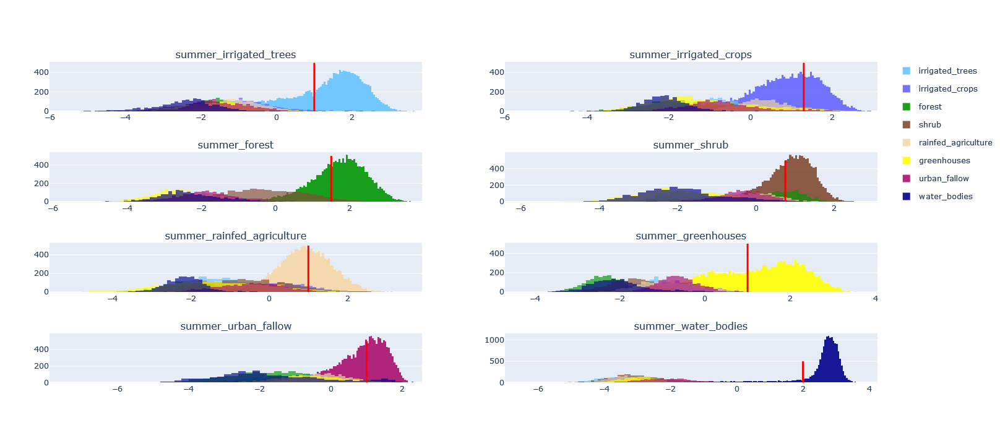

In [6]:
summer_irrigated_trees_threshold = 1
summer_irrigated_crops_threshold = 1.3
summer_forest_threshold = 1.5
summer_shrub_threshold = .75
summer_rainfed_agriculture = 1
summer_greenhouses = 1
summer_urban_fallow = 1
summer_water_bodies = 2 

plot_position = {
    0:(1, 1),
    1:(1, 2),
    2:(2, 1),
    3:(2, 2),
    4:(3, 1),
    5:(3, 2),
    6:(4, 1),
    7:(4, 2),
}

fig = make_subplots(rows=4, cols=2, subplot_titles=tuple(lda_parameters_summer.keys()))

for ind, cl in enumerate(lda_parameters_summer):
    
    X_summer, y_summer, suggested_threshold_summer, lda_intercept_summer, lda_coefficients_summer, X_lda_sklearn_summer, gt_summer = lda_parameters_summer[cl]
    
    _classes = {
        0: 'other',
        1: cl,
    }
    
    _classes_detailed = {}

    for pix_val in y_summer['lc'].unique():
        
        class_name = y_summer[y_summer['lc'] == pix_val]['class'].unique()[0]
        
        if class_name == cl.replace('summer_', ''):
            _classes_detailed[0] = {'name':class_name, 'lc_val':pix_val}
        else:
            _classes_detailed[int(pix_val)] = class_name
    
    if cl == 'summer_irrigated_trees':
        suggested_threshold_summer = summer_irrigated_trees_threshold
    if cl == 'summer_irrigated_crops':
        suggested_threshold_summer = summer_irrigated_crops_threshold
    if cl == 'summer_forest':
        suggested_threshold_summer = summer_forest_threshold
    if cl == 'summer_shrub':
        suggested_threshold_summer = summer_shrub_threshold
    if cl == 'summer_rainfed_agriculture':
        suggested_threshold_summer = summer_rainfed_agriculture
    if cl == 'summer_greenhouses':
        suggested_threshold_summer = summer_greenhouses
    if cl == 'summer_urban_fallow':
        suggested_threshold_summer = summer_urban_fallow
    if cl == 'summer_water_bodies':
        suggested_threshold_summer = summer_water_bodies
    
    fig = get_histogram(X_lda_sklearn_summer, y_summer['lc'], _classes_detailed, suggested_threshold_summer, fig=fig, row=plot_position[ind][0], col=plot_position[ind][1])

fig.update_layout(height=700, width=1400)
fig.show()

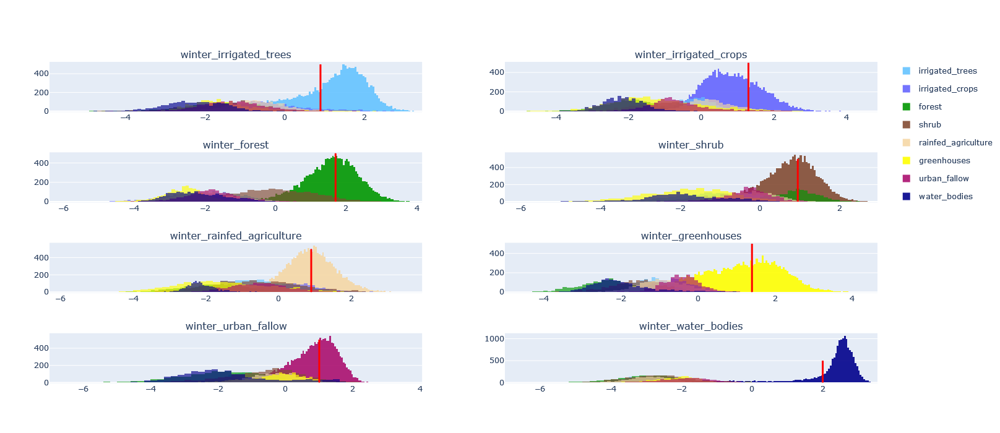

In [9]:
winter_irrigated_trees_threshold = 0.9
winter_irrigated_crops_threshold = 1.3
winter_forest_threshold = 1.7
winter_shrub_threshold = 0.95
winter_rainfed_agriculture = 0.9
winter_greenhouses = 1.4
winter_urban_fallow = 1
winter_water_bodies = 2

plot_position = {
    0: (1, 1),
    1: (1, 2),
    2: (2, 1),
    3: (2, 2),
    4: (3, 1),
    5: (3, 2),
    6: (4, 1),
    7: (4, 2),
}

fig = make_subplots(rows=4, cols=2, subplot_titles=tuple(lda_parameters_winter.keys()))

for ind, cl in enumerate(lda_parameters_winter):

    X_winter, y_winter, suggested_threshold_winter, lda_intercept_winter, lda_coefficients_winter, X_lda_sklearn_winter, gt_winter = lda_parameters_winter[cl]

    if gt_winter:
        _classes = {
            0: 'other',
            1: cl,
        }
    else:
        _classes = {
            0: cl,
            1: 'other',
        }
        
    _classes_detailed = {}
    
    for pix_val in y_winter['lc'].unique():
        
        class_name = y_winter[y_winter['lc'] == pix_val]['class'].unique()[0]
        
        if class_name == cl.replace('winter_', ''):
            _classes_detailed[0] = {'name':class_name, 'lc_val':pix_val}
        else:
            _classes_detailed[int(pix_val)] = class_name

    if cl == 'winter_irrigated_trees':
        suggested_threshold_winter = winter_irrigated_trees_threshold
    if cl == 'winter_irrigated_crops':
        suggested_threshold_winter = winter_irrigated_crops_threshold
    if cl == 'winter_forest':
        suggested_threshold_winter = winter_forest_threshold
    if cl == 'winter_shrub':
        suggested_threshold_winter = winter_shrub_threshold
    if cl == 'winter_rainfed_agriculture':
        suggested_threshold_winter = winter_rainfed_agriculture
    if cl == 'winter_greenhouses':
        suggested_threshold_winter = winter_greenhouses
    if cl == 'winter_urban_fallow':
        suggested_threshold_winter = winter_urban_fallow
    if cl == 'winter_water_bodies':
        suggested_threshold_winter = winter_water_bodies

    fig = get_histogram(X_lda_sklearn_winter, y_winter['lc'], _classes_detailed, suggested_threshold_winter, fig=fig,
                        row=plot_position[ind][0], col=plot_position[ind][1])

fig.update_layout(height=700, width=1400)
fig.show()

In [11]:
CALIBRATION_YEARS = [
    1997,
    2000,
    2009,
]

calibration_data_summer = {}
calibration_data_winter = {}

for year in CALIBRATION_YEARS:
    calibration_data_summer[year] = ee.Image(
        f'{GEE_USER_PATH}/ia_classification/raster/data/{AOI_NAME}/landsat/{DATA_CREATION_METHOD}/feature_data_{AOI_NAME}_summer_{year}'
    )
    
    calibration_data_winter[year] = ee.Image(
        f'{GEE_USER_PATH}/ia_classification/raster/data/{AOI_NAME}/landsat/{DATA_CREATION_METHOD}/feature_data_{AOI_NAME}_winter_{year}'
    )

    
training_areas_winter = {}
training_areas_summer = {}

for year in CALIBRATION_YEARS:
    
    ta_year_summer = None
    
    for ind, cl in enumerate(lda_parameters_summer):
        X_summer, y_summer, suggested_threshold_summer, lda_intercept_summer, lda_coefficients_summer, X_lda_sklearn_summer, gt_summer = lda_parameters_summer[cl]

        if cl == 'summer_irrigated_trees':
            suggested_threshold_summer = summer_irrigated_trees_threshold
        if cl == 'summer_irrigated_crops':
            suggested_threshold_summer = summer_irrigated_crops_threshold
        if cl == 'summer_forest':
            suggested_threshold_summer = summer_forest_threshold
        if cl == 'summer_shrub':
            suggested_threshold_summer = summer_shrub_threshold
        if cl == 'summer_rainfed_agriculture':
            suggested_threshold_summer = summer_rainfed_agriculture
        if cl == 'summer_greenhouses':
            suggested_threshold_summer = summer_greenhouses
        if cl == 'summer_urban_fallow':
            suggested_threshold_summer = summer_urban_fallow
        if cl == 'summer_water_bodies':
            suggested_threshold_summer = summer_water_bodies

        ta_summer = perform_lda_scaling(calibration_data_summer[year], lda_intercept_summer, lda_coefficients_summer, suggested_threshold_summer, gt=gt_summer)

        if ta_year_summer is None:
            ta_year_summer = ta_summer.select('training').rename(cl.replace('summer_', '')).set(f'{cl}_threshold', suggested_threshold_summer)
        else:
            ta_year_summer = ta_year_summer.addBands(ta_summer.select('training').rename(cl.replace('summer_', ''))).set(f'{cl}_threshold', suggested_threshold_summer)
    
    training_areas_summer[year] = ta_year_summer

    ta_year_winter = None
    
    for ind, cl in enumerate(lda_parameters_winter):
        X_winter, y_winter, suggested_threshold_winter, lda_intercept_winter, lda_coefficients_winter, X_lda_sklearn_winter, gt_winter = lda_parameters_winter[cl]

        if cl == 'winter_irrigated_trees':
            suggested_threshold_winter = winter_irrigated_trees_threshold
        if cl == 'winter_irrigated_crops':
            suggested_threshold_winter = winter_irrigated_crops_threshold
        if cl == 'winter_forest':
            suggested_threshold_winter = winter_forest_threshold
        if cl == 'winter_shrub':
            suggested_threshold_winter = winter_shrub_threshold
        if cl == 'winter_rainfed_agriculture':
            suggested_threshold_winter = winter_rainfed_agriculture
        if cl == 'winter_greenhouses':
            suggested_threshold_winter = winter_greenhouses
        if cl == 'winter_urban_fallow':
            suggested_threshold_winter = winter_urban_fallow
        if cl == 'winter_water_bodies':
            suggested_threshold_winter = winter_water_bodies

        ta_winter = perform_lda_scaling(calibration_data_winter[year], lda_intercept_winter, lda_coefficients_winter, suggested_threshold_winter, gt=gt_winter)

        if ta_year_winter is None:
            ta_year_winter = ta_winter.select('training').rename(cl.replace('winter_', '')).set(f'{cl}_threshold', suggested_threshold_winter)
        else:
            ta_year_winter = ta_year_winter.addBands(ta_winter.select('training').rename(cl.replace('winter_', ''))).set(f'{cl}_threshold', suggested_threshold_winter)
    
    training_areas_winter[year] = ta_year_winter

In [12]:
lc_classes = {
    'irrigated_trees':1,
    'irrigated_crops':2,
    'forest':3,
    'shrub':4,
    'rainfed_agriculture':5,
    'greenhouses':6,
    'urban_fallow':7,
    'water_bodies':8,
}

def combine_training_areas(img_training_areas, classes):
    
    # Combine the training areas in to single image
    img_training_areas_summed = img_training_areas.reduce('sum')
    img_training_areas_combined = ee.Image(0)
    
    for cl, pix_val in classes.items():
        
        img_training_areas_combined = img_training_areas_combined.where(img_training_areas.select(cl).eq(1).And(img_training_areas_summed.eq(1)), pix_val)
    
    return img_training_areas_combined.rename('combined_training_areas').addBands(img_training_areas).addBands(img_training_areas_summed.rename('summed_classes'))

tasks = {}


for year in CALIBRATION_YEARS:
    try:
        task_summer = export_to_asset(
                  combine_training_areas(training_areas_summer[year], lc_classes),
                  'image',
                  f"results/random_forest/cdc/{CLF_RUN}/training/training_summer_{year}",
                  AOI_BOUNDS_COORDINATES,
                  SCALE,
                  overwrite=True
              )
        tasks[f'training areas summer {year}'] = task_summer
    except FileExistsError as e:
        print(e)

    try:
        task_winter = export_to_asset(
                  combine_training_areas(training_areas_winter[year], lc_classes),
                  'image',
                  f"results/random_forest/cdc/{CLF_RUN}/training/training_winter_{year}",
                  AOI_BOUNDS_COORDINATES,
                  SCALE,
                  overwrite=True
              )
        tasks[f'training areas winter {year}'] = task_winter
    except FileExistsError as e:
        print(e)

if len(tasks) > 0:
    track_task(tasks)

Export started to projects/earthengine-legacy/assets/users/Postm087/ia_classification/raster/results/random_forest/cdc/all_scenes_p15_p85_evi_savi/training/training_summer_1997
Export started to projects/earthengine-legacy/assets/users/Postm087/ia_classification/raster/results/random_forest/cdc/all_scenes_p15_p85_evi_savi/training/training_winter_1997
Export started to projects/earthengine-legacy/assets/users/Postm087/ia_classification/raster/results/random_forest/cdc/all_scenes_p15_p85_evi_savi/training/training_summer_2000
Export started to projects/earthengine-legacy/assets/users/Postm087/ia_classification/raster/results/random_forest/cdc/all_scenes_p15_p85_evi_savi/training/training_winter_2000
Export started to projects/earthengine-legacy/assets/users/Postm087/ia_classification/raster/results/random_forest/cdc/all_scenes_p15_p85_evi_savi/training/training_summer_2009
Export started to projects/earthengine-legacy/assets/users/Postm087/ia_classification/raster/results/random_forest/